In [ ]:
!which jupyter

In [ ]:
!pip install ultralytics

In [1]:
from ultralytics import YOLO
from PIL import Image
import cv2
import matplotlib.pyplot as plt
import ipywidgets as widgets
from IPython.display import display
import numpy as np
# from scipy.signal import find_peaks
import glob
import os

ModuleNotFoundError: No module named 'ultralytics'

In [3]:
HOME = os.getcwd()
HOME

'C:\\Users\\nimod\\Documents\\Simonin_Doc\\counter_Yolo'

# Crop and select image

In [4]:
List_img = glob.glob(f'{HOME}/raw_images/*.JPG')
List_img

['C:\\Users\\nimod\\Documents\\Simonin_Doc\\counter_Yolo/raw_images\\IMG_0281.JPG',
 'C:\\Users\\nimod\\Documents\\Simonin_Doc\\counter_Yolo/raw_images\\IMG_0282.JPG',
 'C:\\Users\\nimod\\Documents\\Simonin_Doc\\counter_Yolo/raw_images\\IMG_0283.JPG',
 'C:\\Users\\nimod\\Documents\\Simonin_Doc\\counter_Yolo/raw_images\\IMG_0284.JPG',
 'C:\\Users\\nimod\\Documents\\Simonin_Doc\\counter_Yolo/raw_images\\IMG_0285.JPG',
 'C:\\Users\\nimod\\Documents\\Simonin_Doc\\counter_Yolo/raw_images\\IMG_0286.JPG',
 'C:\\Users\\nimod\\Documents\\Simonin_Doc\\counter_Yolo/raw_images\\IMG_0287.JPG',
 'C:\\Users\\nimod\\Documents\\Simonin_Doc\\counter_Yolo/raw_images\\IMG_0288.JPG',
 'C:\\Users\\nimod\\Documents\\Simonin_Doc\\counter_Yolo/raw_images\\IMG_0289.JPG',
 'C:\\Users\\nimod\\Documents\\Simonin_Doc\\counter_Yolo/raw_images\\IMG_0290.JPG',
 'C:\\Users\\nimod\\Documents\\Simonin_Doc\\counter_Yolo/raw_images\\IMG_0292.JPG',
 'C:\\Users\\nimod\\Documents\\Simonin_Doc\\counter_Yolo/raw_images\\IMG_029

In [5]:
# f = '../IMG_0318.JPG'
f=  List_img[0]
# f ='../IMG_0292.JPG'
i = cv2.imread(f)
img = cv2.cvtColor(i, cv2.COLOR_BGR2RGB)
# img_gray = cv2.cvtColor(i, cv2.COLOR_BGR2GRAY)

In [6]:
def plot_crop_lines(img=img,v_min=int(img.shape[0]/3), v_max=int(img.shape[0]*2/3), h_min=int(img.shape[1]/3), h_max=int(img.shape[1]*2/3)):
    im = img.copy()
    lw = 3 # line width in pixel
    # plt.figure(figsize=(16,9))
    im[v_min-lw:v_min+lw,:]=[255,0,0]
    im[v_max-lw:v_max+lw,:]=[255,0,0]
    im[:,h_min-lw:h_min+lw]=[255,0,0]
    im[:,h_max-lw:h_max+lw]=[255,0,0]
    display(Image.fromarray(im))
    # height, width, _ = im.shape
    # plt.plot([v_min,v_min], [0,height], color='r')
    # plt.plot([v_max,v_max], [0,height], color='r')
    # plt.plot([0,width], [h_min,h_min], color='r')
    # plt.plot([0,width], [h_max,h_max], color='r')

In [7]:
def cropping_image(im,v_min, v_max, h_min, h_max):
    im = im[h_min:h_max, v_min:v_max, :]
    return im

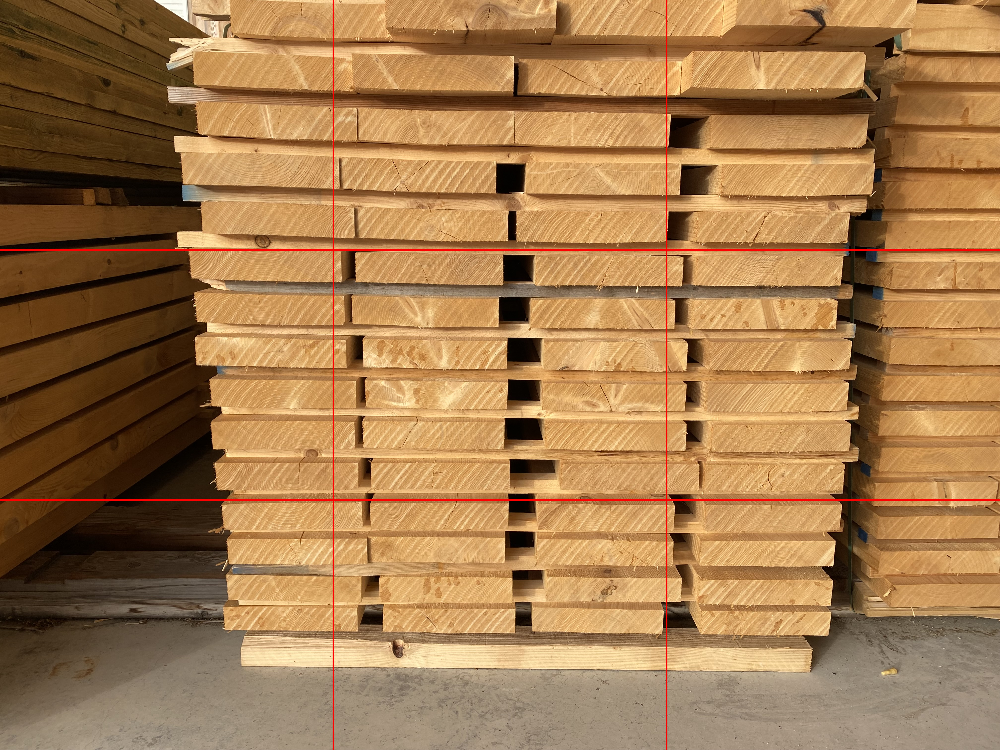

In [8]:
plot_crop_lines(img)

In [9]:
# vert = widgets.IntSlider(value=1100,min=0,max=RGB_output.shape[0],step=10,description='Vert pos:',)
vert_x_min = widgets.IntSlider(value=int(img.shape[1]/10),min=0,max=img.shape[1],step=10,description='Vert min:',)
vert_x_max = widgets.IntSlider(value=int(img.shape[1]*9/10),min=0,max=img.shape[1],step=10,description='Vert max:',)
# hori = widgets.IntSlider(value=1710,min=0,max=RGB_output.shape[1],step=10,description='Hori pos:',)
hori_y_min = widgets.IntSlider(value=int(img.shape[0]/10),min=0,max=img.shape[0],step=10,description='Hori min:',)
hori_y_max = widgets.IntSlider(value=int(img.shape[0]*9/10),min=0,max=img.shape[0],step=10,description='Hori max:',)
# w = widgets.IntSlider(value=100,min=0,max=200,step=10,description='width:',)
# w2 = widgets.IntSlider(value=20,min=0,max=200,step=10,description='width:',)
ui = widgets.HBox([vert_x_min,vert_x_max,hori_y_min,hori_y_max])
# ui2 = widgets.HBox([hori,hori_y_min,hori_y_max, w2])
graph = widgets.interactive_output(plot_crop_lines,{'v_min':vert_x_min,'v_max':vert_x_max,'h_min': hori_y_min,'h_max':hori_y_max})
display(ui,graph)    

Output()

In [ ]:
def plot_crop_lines(im=img,v_min=0, v_max=0, h_min=200, h_max=300):
    plt.figure(figsize=(16,9))
    plt.imshow(im)
    height, width, _ = im.shape
    plt.plot([v_min,v_min], [0,height], color='r')
    plt.plot([v_max,v_max], [0,height], color='r')
    plt.plot([0,width], [h_min,h_min], color='r')
    plt.plot([0,width], [h_max,h_max], color='r')

In [12]:
# Load a pretrained model
model_path = r'C:\Users\nimod\Documents\Simonin_Doc\counter_Yolo\model_v2\v2.1_25_epochs\last.pt'
model = YOLO(model_path)

In [13]:
image_to_predict = [r'C:\Users\nimod\Documents\Simonin_Doc\counter_Yolo\raw_images\IMG_0281.JPG',
                    r'C:\Users\nimod\Documents\Simonin_Doc\counter_Yolo\raw_images\IMG_0282.JPG',
                   r'C:\Users\nimod\Documents\Simonin_Doc\counter_Yolo\raw_images\IMG_0283.JPG',
                    r'C:\Users\nimod\Documents\Simonin_Doc\counter_Yolo\raw_images\IMG_0284.JPG',
                    r'C:\Users\nimod\Documents\Simonin_Doc\counter_Yolo\raw_images\IMG_0285.JPG',
                    r'C:\Users\nimod\Documents\Simonin_Doc\counter_Yolo\raw_images\IMG_0286.JPG',
                    r'C:\Users\nimod\Documents\Simonin_Doc\counter_Yolo\raw_images\IMG_0287.JPG',
                    r'C:\Users\nimod\Documents\Simonin_Doc\counter_Yolo\raw_images\IMG_0288.JPG',
                    r'C:\Users\nimod\Documents\Simonin_Doc\counter_Yolo\raw_images\IMG_0289.JPG'
                   ]
# image_to_predict[4]

In [14]:
# Run inference on source
results = model(source=image_to_predict
                ,show=False, conf=0.25,save=True, line_width=3)


0: 608x800 78 Planches, 1: 608x800 81 Planches, 2: 608x800 85 Planches, 3: 608x800 104 Planches, 4: 608x800 125 Planches, 5: 608x800 73 Planches, 6: 608x800 82 Planches, 7: 608x800 145 Planches, 8: 608x800 115 Planches, 3505.5ms
Speed: 8.7ms preprocess, 389.5ms inference, 1.0ms postprocess per image at shape (1, 3, 608, 800)
Results saved to runs\detect\predict


In [25]:
results

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'Bardage', 1: 'Planche'}
 orig_img: array([[[ 33,  64,  89],
         [ 34,  65,  90],
         [ 29,  60,  85],
         ...,
         [ 63, 116, 166],
         [ 63, 116, 166],
         [ 63, 116, 166]],
 
        [[ 23,  54,  79],
         [ 27,  58,  83],
         [ 30,  61,  86],
         ...,
         [ 62, 115, 165],
         [ 62, 115, 165],
         [ 62, 115, 165]],
 
        [[ 15,  46,  71],
         [ 18,  49,  74],
         [ 20,  51,  76],
         ...,
         [ 60, 113, 163],
         [ 60, 113, 163],
         [ 61, 114, 164]],
 
        ...,
 
        [[118, 137, 152],
         [117, 136, 151],
         [115, 134, 149],
         ...,
         [125, 141, 154],
         [125, 141, 154],
         [125, 141, 154]],
 
        [[117, 136, 151],
         [117, 136, 151],
         [116, 135, 150],
         ...,
         [126,